### Import libraries

In [1]:
from datetime import datetime

import folium
from folium.plugins import HeatMap

import pandas as pd
from pandas import Timestamp
pd.options.display.max_columns = 999
from sklearn.preprocessing import MinMaxScaler
scaler = MinMaxScaler()

import matplotlib.pyplot as plt
from matplotlib.colors import LinearSegmentedColormap
import seaborn as sns
import pyproj
from shapely.geometry import Point
import geopandas as gpd

# Using Plotline
from plotnine import *
from plotnine import scale_x_datetime, element_text
from mizani.breaks import date_breaks
from mizani.formatters import date_format

import plotly.graph_objects as go

plt.style.use('ggplot')
%matplotlib inline

/Users/mahsumkocabey/opt/anaconda3/lib/python3.8/site-packages/pandas/core/computation/expressions.py:20: UserWarning: Pandas requires version '2.7.3' or newer of 'numexpr' (version '2.7.1' currently installed).
  from pandas.core.computation.check import NUMEXPR_INSTALLED


In [2]:
# colour blind codes
colors_code = {
    'blue':    '#377eb8', 
    'orange':  '#ff7f00',
    'green':   '#4daf4a',
    'pink':    '#f781bf',
    'brown':   '#a65628',
    'purple':  '#984ea3',
    'gray':    '#999999',
    'red':     '#e41a1c',
    'yellow':  '#dede00'
} 

# Create a color gradient
colors = [colors_code['green'], colors_code['red']]
cmap = LinearSegmentedColormap.from_list('name', colors)

### Import the Data

In [3]:
# Import the data set
london = pd.read_csv('../data/LFB/LFB Incident data 2020 to 2023.csv')

In [4]:
london['DateOfCall'] = pd.to_datetime(london['DateOfCall'], format='%d %b %Y')

In [5]:
london.head()

,IncidentNumber,DateOfCall,CalYear,TimeOfCall,HourOfCall,IncidentGroup,StopCodeDescription,SpecialServiceType,PropertyCategory,PropertyType,AddressQualifier,Postcode_full,Postcode_district,UPRN,USRN,IncGeo_BoroughCode,IncGeo_BoroughName,ProperCase,IncGeo_WardCode,IncGeo_WardName,IncGeo_WardNameNew,Easting_m,Northing_m,Easting_rounded,Northing_rounded,Latitude,Longitude,FRS,IncidentStationGround,FirstPumpArriving_AttendanceTime,FirstPumpArriving_DeployedFromStation,SecondPumpArriving_AttendanceTime,SecondPumpArriving_DeployedFromStation,NumStationsWithPumpsAttending,NumPumpsAttending,PumpCount,PumpHoursRoundUp,Notional Cost (£),NumCalls
0,000001-01012020,2020-01-01,2020,00:02:11,0,Special Service,Special Service,Lift Release,Dwelling,Purpose Built Flats/Maisonettes - 4 to 9 storeys,Within same building,NaN,SE1,0.000000e+00,21901000,E09000022,LAMBETH,Lambeth,E05014118,Waterloo & South Bank,Waterloo & South Bank,NaN,NaN,531050,179550,NaN,NaN,London,Lambeth,NaN,NaN,NaN,NaN,1.0,1.0,1.0,1.0,339.0,3.0
1,000003-01012020,2020-01-01,2020,00:06:30,0,Fire,Primary Fire,NaN,Non Residential,Private Garden Shed,On land associated with building,NaN,UB8,0.000000e+00,21402055,E09000017,HILLINGDON,Hillingdon,E05013566,Colham & Cowley,Colham & Cowley,NaN,NaN,506750,181550,NaN,NaN,London,Hillingdon,324.0,Hillingdon,292.0,Hillingdon,1.0,2.0,2.0,1.0,339.0,3.0
2,000004-01012020,2020-01-01,2020,00:07:07,0,Special Service,Special Service,Lift Release,Dwelling,Purpose Built Flats/Maisonettes - 4 to 9 storeys,Within same building,NaN,N6,0.000000e+00,21106425,E09000014,HARINGEY,Haringey,E05013592,Highgate,Highgate,NaN,NaN,528250,187850,NaN,NaN,London,Hornsey,NaN,NaN,NaN,NaN,1.0,1.0,1.0,1.0,339.0,1.0
3,000008-01012020,2020-01-01,2020,00:11:05,0,False Alarm,AFA,NaN,Non Residential,Telephone exchange,Correct incident location,TW9 1LW,TW9,1.000225e+10,22403714,E09000027,RICHMOND UPON THAMES,Richmond Upon thames,E05013786,South Richmond,South Richmond,518296.0,174887.0,518250,174850,51.460614,-0.298579,London,Richmond,195.0,Richmond,NaN,NaN,1.0,1.0,1.0,1.0,339.0,1.0
4,000009-01012020,2020-01-01,2020,00:11:16,0,Fire,Secondary Fire,NaN,Outdoor Structure,Small refuse/rubbish container,On land associated with building,N9 8NB,N9,2.070908e+08,20703225,E09000010,ENFIELD,Enfield,E05013685,Lower Edmonton,Lower Edmonton,535304.0,194202.0,535350,194250,51.630370,-0.046492,London,Edmonton,426.0,Edmonton,NaN,NaN,1.0,1.0,1.0,1.0,339.0,1.0


In [6]:
london.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 343407 entries, 0 to 343406
Data columns (total 39 columns):
 #   Column                                  Non-Null Count   Dtype         
---  ------                                  --------------   -----         
 0   IncidentNumber                          343407 non-null  object        
 1   DateOfCall                              343407 non-null  datetime64[ns]
 2   CalYear                                 343407 non-null  int64         
 3   TimeOfCall                              343407 non-null  object        
 4   HourOfCall                              343407 non-null  int64         
 5   IncidentGroup                           343407 non-null  object        
 6   StopCodeDescription                     343407 non-null  object        
 7   SpecialServiceType                      122583 non-null  object        
 8   PropertyCategory                        343407 non-null  object        
 9   PropertyType                         

In [7]:
london.describe()

,DateOfCall,CalYear,HourOfCall,UPRN,USRN,Easting_m,Northing_m,Easting_rounded,Northing_rounded,Latitude,Longitude,FirstPumpArriving_AttendanceTime,SecondPumpArriving_AttendanceTime,NumStationsWithPumpsAttending,NumPumpsAttending,PumpCount,PumpHoursRoundUp,Notional Cost (£),NumCalls
count,343407,343407.000000,343407.000000,3.434070e+05,3.434070e+05,149927.000000,149927.000000,343407.000000,343407.000000,149927.000000,149927.000000,323126.000000,125444.000000,338318.000000,338318.000000,340596.000000,340499.000000,340499.000000,343404.000000
mean,2021-08-21 07:53:54.933475584,2021.135600,13.380781,1.933031e+10,2.045220e+07,530674.654652,180318.416776,530660.859126,180469.298966,51.334163,-0.117888,310.278780,389.397237,1.406059,1.550736,1.601410,1.370298,483.972570,1.315034
min,2020-01-01 00:00:00,2020.000000,0.000000,0.000000e+00,4.200558e+06,503587.000000,155901.000000,503550.000000,155950.000000,0.000000,-0.510069,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,339.000000,1.000000
25%,2020-11-11 00:00:00,2020.000000,9.000000,0.000000e+00,2.040118e+07,524832.500000,175747.000000,525150.000000,175950.000000,51.465610,-0.201813,228.000000,297.000000,1.000000,1.000000,1.000000,1.000000,346.000000,1.000000
50%,2021-09-09 00:00:00,2021.000000,14.000000,0.000000e+00,2.120131e+07,530878.000000,180960.000000,530950.000000,181050.000000,51.512583,-0.115684,292.000000,367.000000,1.000000,1.000000,1.000000,1.000000,352.000000,1.000000
75%,2022-06-07 00:00:00,2022.000000,18.000000,1.001023e+10,2.210081e+07,537116.000000,185100.000000,536450.000000,185250.000000,51.549371,-0.023999,370.000000,455.000000,2.000000,2.000000,2.000000,1.000000,364.000000,1.000000
max,2023-01-31 00:00:00,2023.000000,23.000000,2.000040e+11,9.999042e+07,560461.000000,200885.000000,611150.000000,302450.000000,51.691412,0.313635,1200.000000,1200.000000,14.000000,14.000000,156.000000,680.000000,247520.000000,111.000000
std,NaN,0.865314,6.295498,4.457665e+10,4.498626e+06,10528.097783,7579.950009,9776.397687,7476.839806,2.976194,0.151599,131.406302,144.610117,0.788124,0.915577,1.388974,4.454444,1578.062474,1.493917


### EDA

#### Trend of Calls between Jan 2020 - Feb 2023
1. First Graph is using Plotline and ggplot
2. Second Graph is Interavtive plotly graph

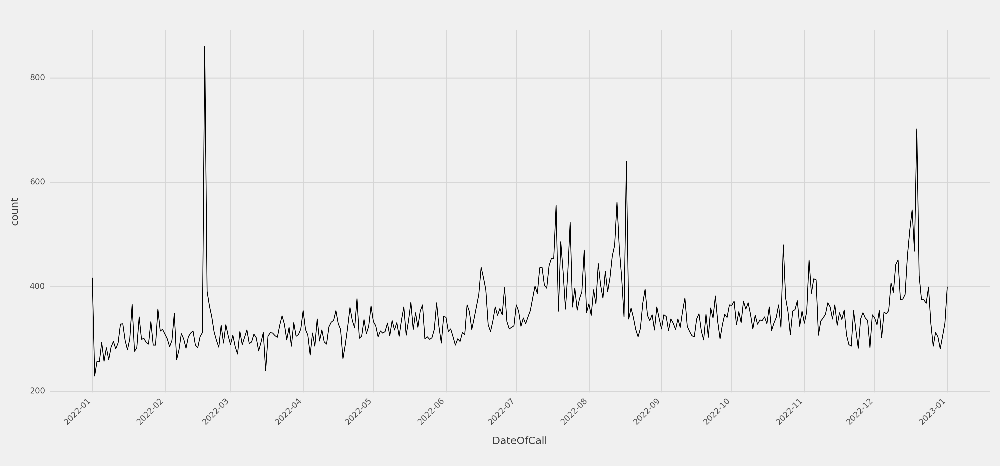

<Figure Size: (1500 x 700)>

In [8]:
start_date = Timestamp("2022-01-01")
end_date = Timestamp("2023-01-01")

# Filter dataframe based on date range
london_filtered = london[(london['DateOfCall'] >= start_date) & (london['DateOfCall'] <= end_date)]

(ggplot(data=london_filtered) +
 aes(x='DateOfCall', group=1) +
 stat_count(geom='line') +
 theme_538() +
 scale_x_datetime(breaks=date_breaks('1 month'), labels=date_format('%Y-%m')) +
 theme(axis_text_x=element_text(rotation=45, hjust=1), figure_size=(15,7))
)


In [9]:
def lfb_time_series(start_date, end_date):
    start_date = datetime.strptime(start_date, '%Y-%m-%d').date()
    end_date = datetime.strptime(end_date, '%Y-%m-%d').date()

    # Filter dataframe based on date range
    london_filtered = london[(london['DateOfCall'] >= start_date) 
                             & (london['DateOfCall'] <= end_date)]
    
    lfb = london_filtered.groupby(['DateOfCall'])['NumCalls'].sum().reset_index()

    fig = go.Figure([go.Scatter(x=lfb['DateOfCall'], y=lfb['NumCalls'],
                            mode='lines+markers',
                            name='lines+markers')])

    # Add hover text
    fig.update_traces(hoverinfo='text', hovertext=
        ['Date: {}<br>Total Contacts: {}'.format(i, j) for i, j in zip(lfb['DateOfCall'], lfb['NumCalls'])])

    # Add labels
    start_date = lfb['DateOfCall'].min().strftime('%Y-%m-%d')
    end_date = lfb['DateOfCall'].max().strftime('%Y-%m-%d')
    fig.update_layout(title_text="From {} to {}".format(start_date, end_date),
                      xaxis_title="Date",
                      yaxis_title="Total Num of Calls")
    
    return fig

**Comparison of Number of calls per year**
Given that:
* year_2020_2021:  130754.0
* year_2021_2022:  140430.0
* year_2022_2023:  169500.0

The number of calls LFB recevied increased by huge number each year:

- Proportion of 2020-21 vs 2021-22:  %6.89
- Proportion of 2021-22 vs 2022-23:  %17.15

In [10]:
london['DateOfCall'] = pd.to_datetime(london['DateOfCall']).dt.date

## year 2020-2021
start_date = datetime.strptime("2020-01-01", "%Y-%m-%d").date()
end_date = datetime.strptime("2021-01-01", "%Y-%m-%d").date()

# Filter dataframe based on date range
london_filtered_2020 = london[(london['DateOfCall'] >= start_date) 
                         & (london['DateOfCall'] <= end_date)]


year_2020_2021 = london_filtered_2020.groupby(['DateOfCall'])['NumCalls'].sum()

## year 2021-2022
start_date = datetime.strptime("2021-01-01", "%Y-%m-%d").date()
end_date = datetime.strptime("2022-01-01", "%Y-%m-%d").date()

# Filter dataframe based on date range
london_filtered_2021 = london[(london['DateOfCall'] >= start_date) 
                         & (london['DateOfCall'] <= end_date)]


year_2021_2022 = london_filtered_2021.groupby(['DateOfCall'])['NumCalls'].sum()

## year 2022-2023
start_date = datetime.strptime("2022-01-01", "%Y-%m-%d").date()
end_date = datetime.strptime("2023-01-01", "%Y-%m-%d").date()

# Filter dataframe based on date range
london_filtered_2022 = london[(london['DateOfCall'] >= start_date) 
                         & (london['DateOfCall'] <= end_date)]


year_2022_2023 = london_filtered_2022.groupby(['DateOfCall'])['NumCalls'].sum()

print("year_2020_2021: ", str(year_2020_2021.sum()))
print("year_2021_2022: ", str(year_2021_2022.sum()))
print("year_2022_2023: ", str(year_2022_2023.sum()))
print("Proportion of 2020-21 vs 2021-22: ", "%"+str(round(((1 - year_2020_2021.sum() / year_2021_2022.sum()) * 100), 2)))
print("Proportion of 2021-22 vs 2022-23: ", "%"+str(round(((1 - year_2021_2022.sum() / year_2022_2023.sum()) * 100), 2)))

year_2020_2021:  130754.0
year_2021_2022:  140430.0
year_2022_2023:  169500.0
Proportion of 2020-21 vs 2021-22:  %6.89
Proportion of 2021-22 vs 2022-23:  %17.15


**Plotting time series of LFB Calls**
1. Last 3 year
2. Last year
3. Between last spring and summer season
4. Last Summer

In [11]:
fig = lfb_time_series("2020-01-01", "2023-01-31")
fig.show()

In [12]:
fig = lfb_time_series("2022-01-01", "2023-01-31")
fig.show()

In [13]:
fig = lfb_time_series("2022-03-01", "2022-08-31")
fig.show()

In [14]:
fig = lfb_time_series("2022-06-01", "2022-08-31")
fig.show()

**Most calls dates in ascending order**


In [15]:
london.groupby(['DateOfCall'])['NumCalls'].sum().sort_values(ascending=False)

DateOfCall
2022-07-19    1492.0
2021-07-12    1382.0
2021-07-25    1313.0
2022-07-24    1075.0
2022-02-18    1074.0
               ...  
2020-05-03     236.0
2021-01-17     231.0
2021-03-01     226.0
2020-04-02     223.0
2020-05-04     220.0
Name: NumCalls, Length: 1127, dtype: float64

**Last Summer vs Last Year Total Calls**

In [16]:
london['DateOfCall'] = pd.to_datetime(london['DateOfCall']).dt.date

## LAST YEAR
start_date = datetime.strptime("2022-01-01", "%Y-%m-%d").date()
end_date = datetime.strptime("2023-01-01", "%Y-%m-%d").date()

# Filter dataframe based on date range
london_filtered_last_year = london[(london['DateOfCall'] >= start_date) 
                         & (london['DateOfCall'] <= end_date)]


last_year = london_filtered_last_year.groupby(['DateOfCall'])['NumCalls'].sum()



## LAST SUMMER
start_date = datetime.strptime("2022-06-01", "%Y-%m-%d").date()
end_date = datetime.strptime("2022-08-31", "%Y-%m-%d").date()

# Filter dataframe based on date range
london_filtered_last_summer = london[(london['DateOfCall'] >= start_date) 
                         & (london['DateOfCall'] <= end_date)]

last_summer = london_filtered_last_summer.groupby(['DateOfCall'])['NumCalls'].sum()


print("Last year: ", str(last_year.sum()))
print("Last summer: ", str(last_summer.sum()))
print("Proportion: ", "%"+str(round((last_summer.sum() / last_year.sum() * 100), 2)))


Last year:  169500.0
Last summer:  53349.0
Proportion:  %31.47


**Call trend by the hour of day**
* From the distribution, we can clearly see that the number of calls are higher in PM compare to AM. 
* 18:00 being the highest, following with 17:00 and 19:00
* Count of calls starts increasing from 06:00 till 18:00, then starts descreasing again gradually
* Last Summer almost had same pattern of calls with last 3 years of all

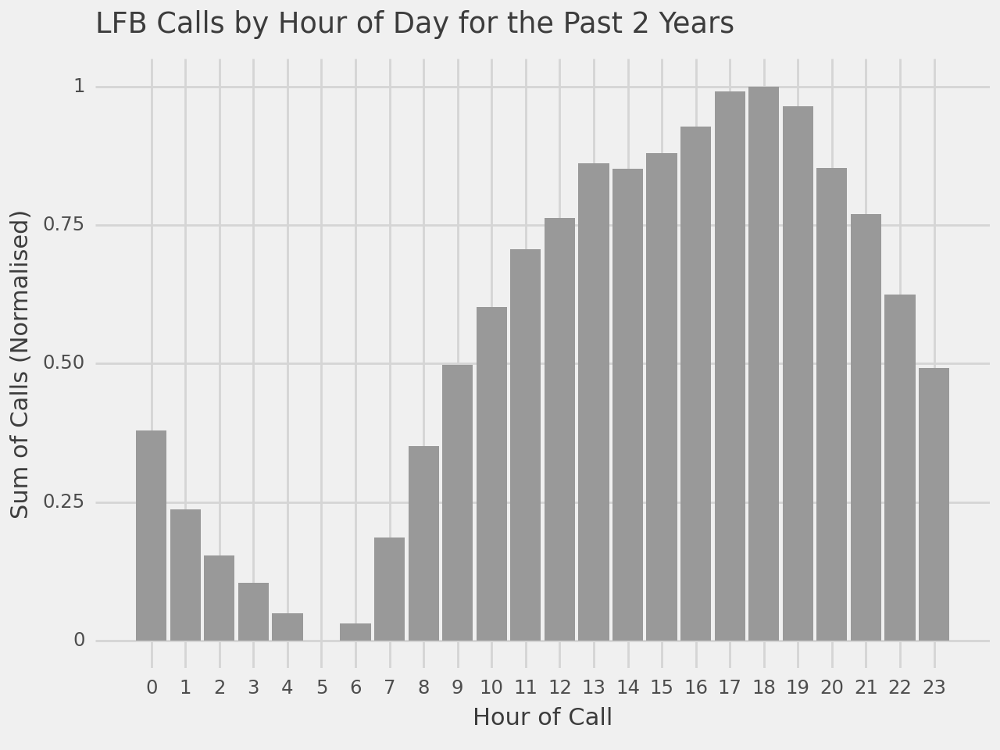

<Figure Size: (640 x 480)>

In [17]:
start_date = pd.Timestamp("2021-01-01").date()
end_date = pd.Timestamp("2023-01-31").date()

# Filter dataframe based on date range
london_filtered = london[(london['DateOfCall'] >= start_date) 
                         & (london['DateOfCall'] <= end_date)]

# Create a new dataframe where each 'HourOfCall' is associated with the average of 'NumCalls'
london_hourly = london_filtered.groupby('HourOfCall')['NumCalls'].sum().reset_index()
london_hourly[['NumCalls_norm']] = scaler.fit_transform(london_hourly[['NumCalls']])


# Now, plot this data with ggplot
(ggplot(data=london_hourly) 
 + aes(x='HourOfCall', y='NumCalls_norm') 
 + geom_col(fill=colors_code['gray']) 
 + ggtitle('LFB Calls by Hour of Day for the Past 2 Years')
 + xlab('Hour of Call') 
 + ylab('Sum of Calls (Normalised)') 
 + theme_538() 
 + scale_x_continuous(breaks=range(0, 24, 1)))


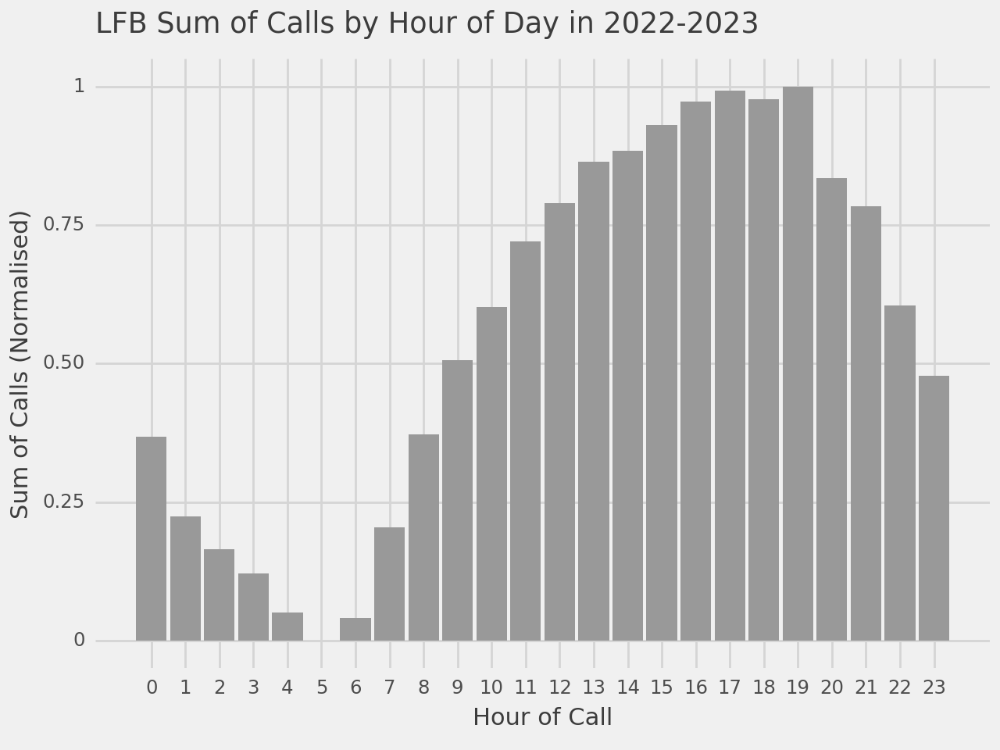

<Figure Size: (640 x 480)>

In [18]:
start_date = pd.Timestamp("2022-01-01").date()
end_date = pd.Timestamp("2023-01-31").date()

# Filter dataframe based on date range
london_filtered = london[(london['DateOfCall'] >= start_date) 
                         & (london['DateOfCall'] <= end_date)]

# Create a new dataframe where each 'HourOfCall' is associated with the average of 'NumCalls'
london_hourly = london_filtered.groupby('HourOfCall')['NumCalls'].sum().reset_index()
london_hourly[['NumCalls_norm']] = scaler.fit_transform(london_hourly[['NumCalls']])

# Now, plot this data with ggplot
(ggplot(data=london_hourly) 
 + aes(x='HourOfCall', y='NumCalls_norm') 
 + geom_col(fill=colors_code['gray']) 
 + ggtitle('LFB Sum of Calls by Hour of Day in 2022-2023')
 + xlab('Hour of Call') 
 + ylab('Sum of Calls (Normalised)') 
 + theme_538()
 + scale_x_continuous(breaks=range(0, 24, 1)))


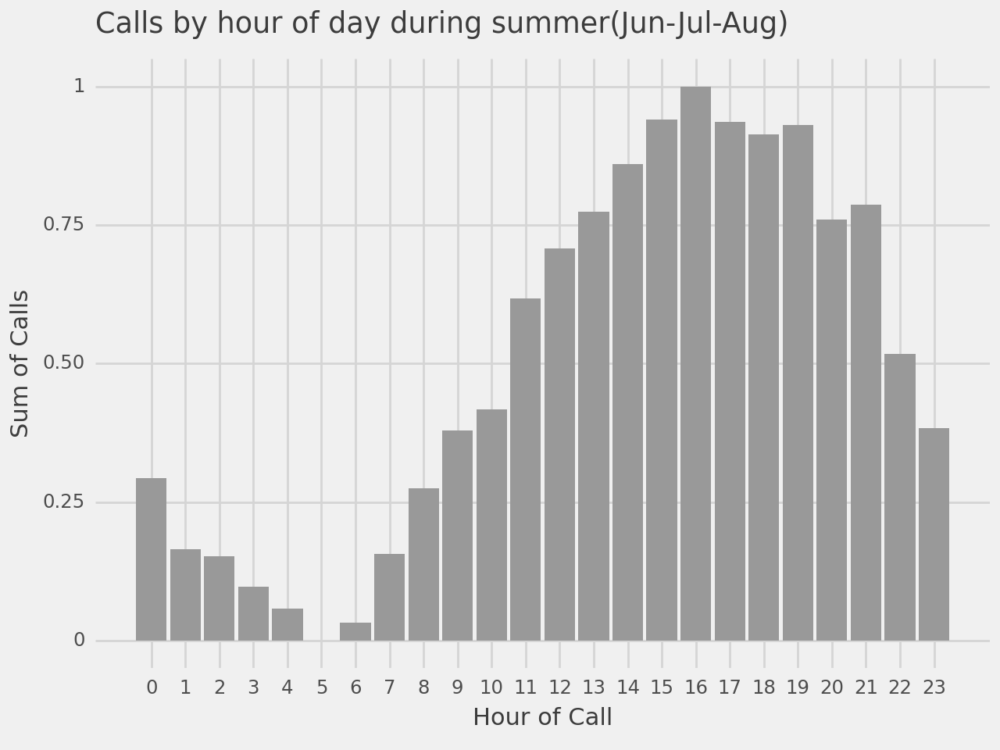

<Figure Size: (640 x 480)>

In [19]:
start_date = pd.Timestamp("2022-06-01").date()
end_date = pd.Timestamp("2022-08-31").date()

# Filter dataframe based on date range
london_filtered = london[(london['DateOfCall'] >= start_date) 
                         & (london['DateOfCall'] <= end_date)]

# Create a new dataframe where each 'HourOfCall' is associated with the sum of 'NumCalls'
london_hourly = london_filtered.groupby('HourOfCall')['NumCalls'].sum().reset_index()
london_hourly[['NumCalls_norm']] = scaler.fit_transform(london_hourly[['NumCalls']])

# Now, plot this data with ggplot
(ggplot(data=london_hourly) 
 + aes(x='HourOfCall', y='NumCalls_norm') 
 + geom_col(fill=colors_code['gray']) 
 + ggtitle('Calls by hour of day during summer(Jun-Jul-Aug)')
 + xlab('Hour of Call') 
 + ylab('Sum of Calls') 
 + theme_538()
 + scale_x_continuous(breaks=range(0, 24, 1)))

**Different Types of Incidents?**
* The most number of calls were from AFA or Automatic Fire Alarm
* Special Services are non-emergency situations.

In [20]:
london.groupby(['StopCodeDescription']).size().sort_values(ascending=False)

StopCodeDescription
AFA                                      130150
Special Service                          120615
False alarm - Good intent                 34849
Primary Fire                              26842
Secondary Fire                            25794
False alarm - Malicious                    3045
Flood call attended - Batch mobilised      1968
Use of Special Operations Room               72
Chimney Fire                                 56
Late Call                                    16
dtype: int64

<Axes: title={'center': 'Calls by Incident Type'}, ylabel='StopCodeDescription'>

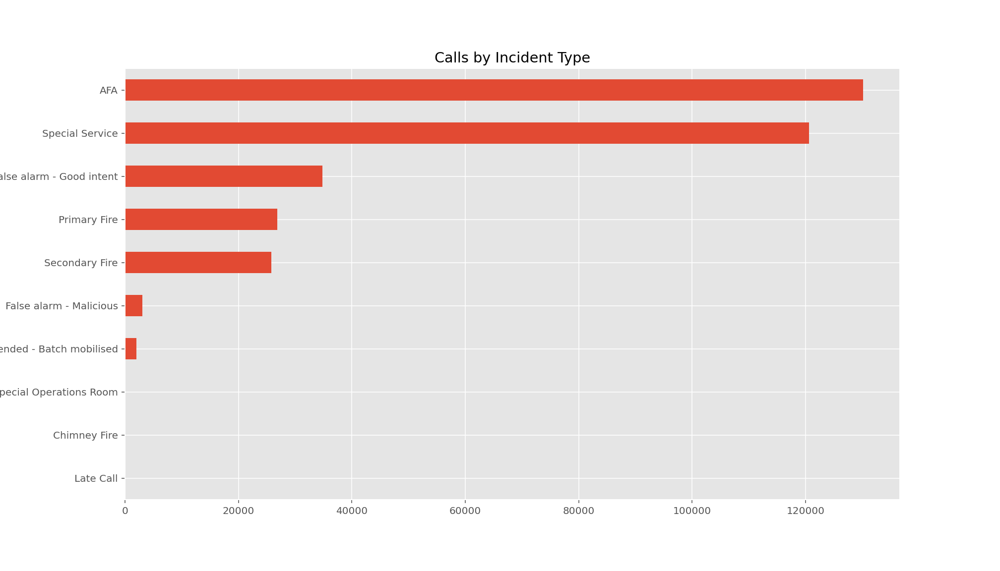

In [21]:
london.groupby(['StopCodeDescription']).size().sort_values()\
    .plot(kind='barh', figsize=[14,8], title='Calls by Incident Type')


**Special Service Type**

In [22]:
london[london['StopCodeDescription'] == 'Special Service'].groupby(
    ['SpecialServiceType']).size().sort_values(ascending=False)

SpecialServiceType
Effecting entry/exit               27977
Flooding                           22490
Lift Release                       16141
RTC                                12261
No action (not false alarm)        12084
Assist other agencies               7229
Making Safe (not RTC)               3980
Hazardous Materials incident        2890
Medical Incident                    2885
Animal assistance incidents         2724
Advice Only                         2130
Spills and Leaks (not RTC)          1915
Removal of objects from people      1819
Other rescue/release of persons     1259
Suicide/attempts                     924
Other Transport incident             820
Evacuation (no fire)                 721
Rescue or evacuation from water      217
Stand By                             147
Water provision                        2
dtype: int64

In [23]:
london.groupby(['IncidentGroup']).size().sort_values(ascending=False)

IncidentGroup
False Alarm        168044
Special Service    122655
Fire                52708
dtype: int64

<Axes: title={'center': 'Calls by Incident Group'}, ylabel='IncidentGroup'>

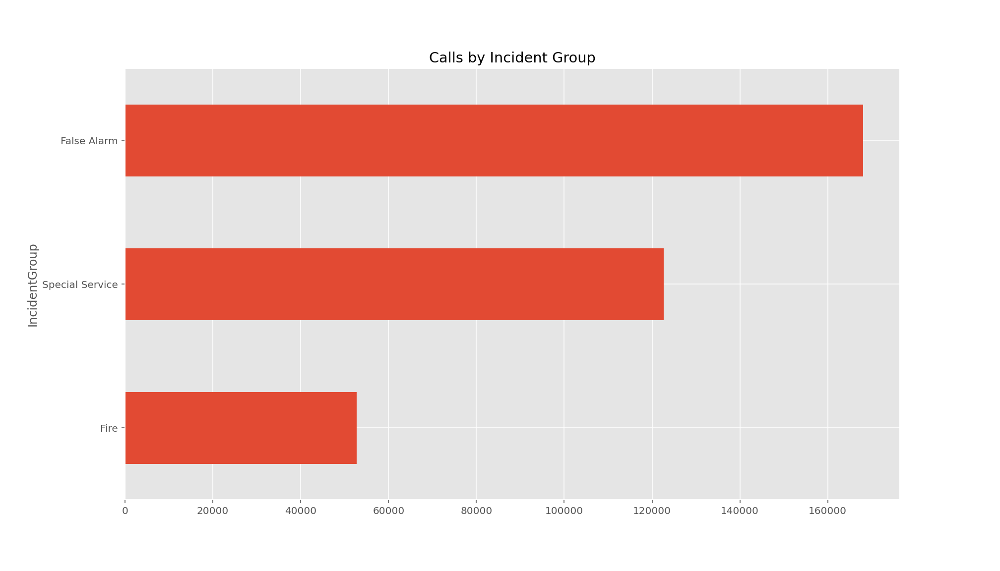

In [24]:
london.groupby(['IncidentGroup']).size().sort_values()\
    .plot(kind='barh', figsize=[14,8], title='Calls by Incident Group')

In [25]:
# Execute the command and store the result
result = london.groupby(['ProperCase' ,'IncidentGroup']).size().sort_values(ascending=False)

# Convert the result to a DataFrame for better formatting
result_df = result.reset_index(name='Count')

# Use pandas' set_option method to display all rows
pd.set_option('display.max_rows', None)

false_alarm = result_df[result_df['IncidentGroup'] == 'False Alarm'].reset_index(drop=True)
special_service = result_df[result_df['IncidentGroup'] == 'Special Service'].reset_index(drop=True)
fire = result_df[result_df['IncidentGroup'] == 'Fire'].reset_index(drop=True)

<Axes: title={'center': 'False Alarm Calls by Each Borough'}, ylabel='ProperCase'>

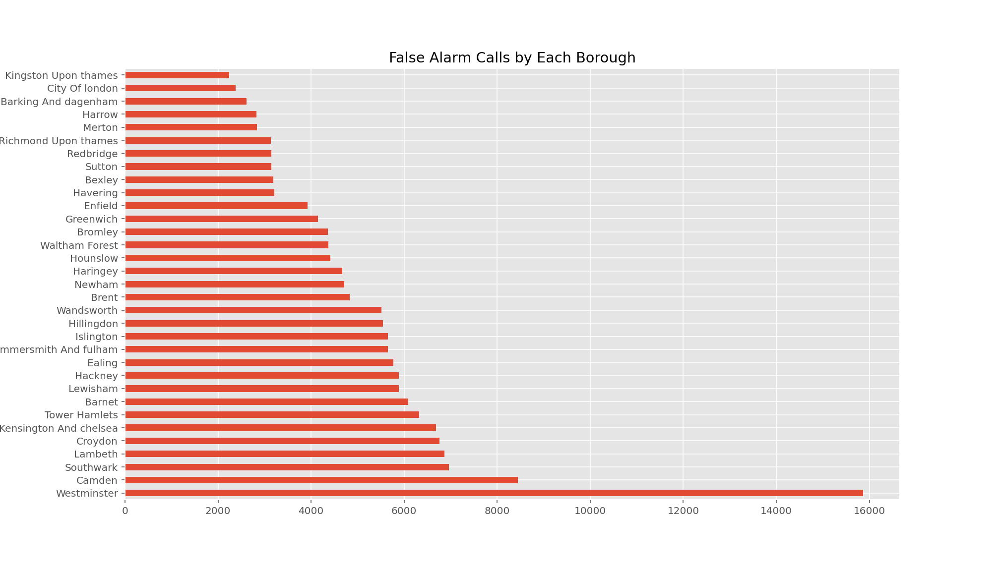

In [26]:
false_alarm.set_index('ProperCase')['Count'].plot(kind='barh',figsize=[14,8], title='False Alarm Calls by Each Borough')

<Axes: title={'center': 'Special Service Calls by Each Borough'}, ylabel='ProperCase'>

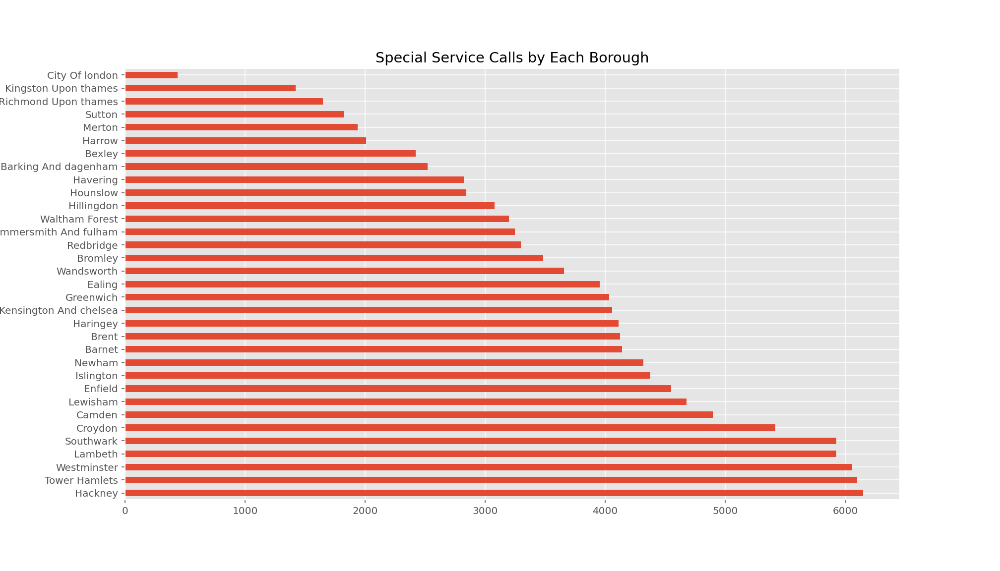

In [27]:
special_service.set_index('ProperCase')['Count'].plot(kind='barh',figsize=[14,8], title='Special Service Calls by Each Borough')

<Axes: title={'center': 'Fire Calls by Each Borough'}, ylabel='ProperCase'>

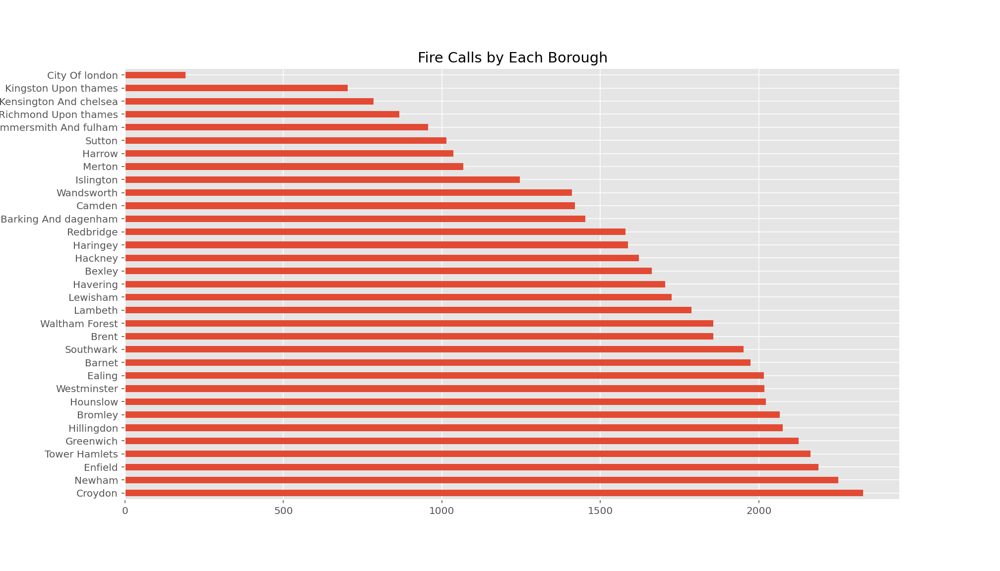

In [28]:
fire.set_index('ProperCase')['Count'].plot(kind='barh',figsize=[14,8], title='Fire Calls by Each Borough')


In [29]:
london.groupby(['PropertyCategory']).size().sort_values(ascending=False)

PropertyCategory
Dwelling             192153
Non Residential       68542
Outdoor               28002
Road Vehicle          21181
Other Residential     17853
Outdoor Structure     15062
Rail Vehicle            287
Boat                    186
Aircraft                141
dtype: int64

<Axes: title={'center': 'Calls by Property Category'}, ylabel='PropertyCategory'>

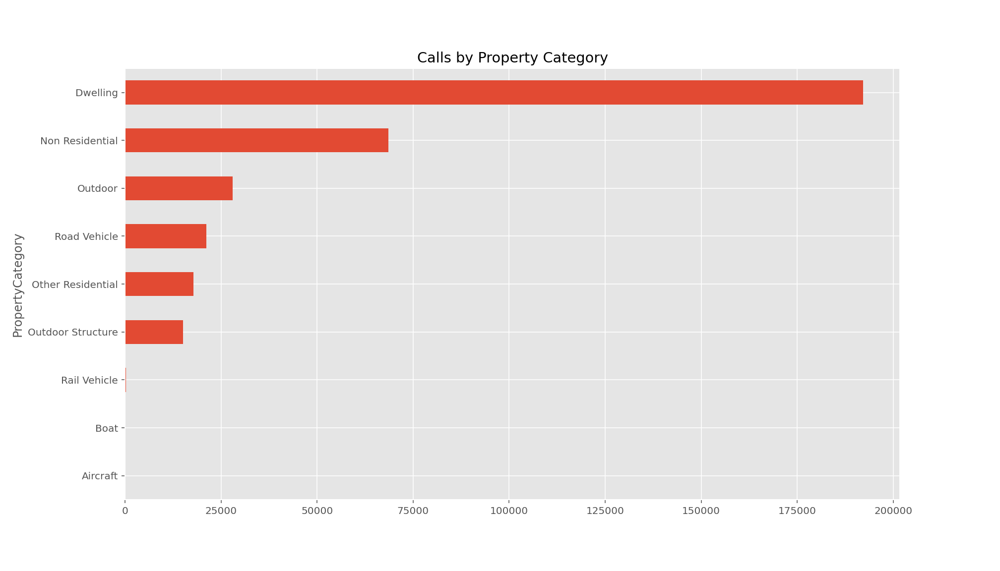

In [30]:
london.groupby(['PropertyCategory']).size().sort_values()\
    .plot(kind='barh', figsize=[14,8], title='Calls by Property Category')

#### Borough

In [31]:
lfb_by_borough = london.groupby(['IncGeo_BoroughName'])["NumCalls"].sum().sort_values(ascending=False)
# Convert series to dataframe
lfb_by_borough_df = lfb_by_borough.reset_index()
# Make it camel case
lfb_by_borough_df['IncGeo_BoroughName'] = lfb_by_borough_df['IncGeo_BoroughName'].str.title()

# Convert dataframe back to series
lfb_by_borough = lfb_by_borough_df.set_index('IncGeo_BoroughName')['NumCalls']

In [32]:
norm = plt.Normalize(lfb_by_borough.min(), lfb_by_borough.max())

<ipython-input-33-b2100a133a17>:3: MatplotlibDeprecationWarning:

Unable to determine Axes to steal space for Colorbar. Using gca(), but will raise in the future. Either provide the *cax* argument to use as the Axes for the Colorbar, provide the *ax* argument to steal space from it, or add *mappable* to an Axes.



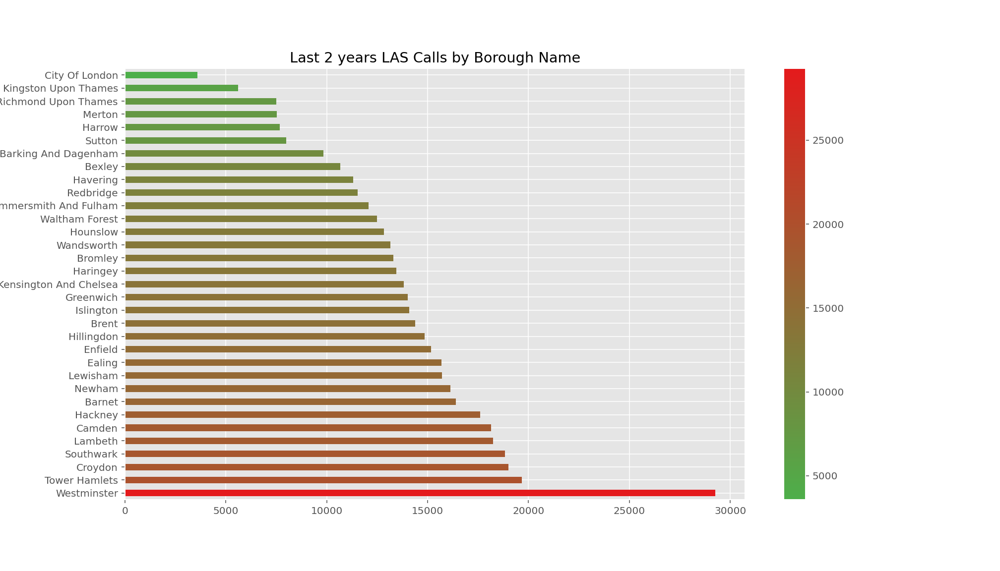

In [33]:
# Plot
lfb_by_borough.plot(kind='barh', figsize=[14,8], title='Last 2 years LAS Calls by Borough Name', color=cmap(norm(lfb_by_borough.values)))
plt.colorbar(plt.cm.ScalarMappable(norm=norm, cmap=cmap))
plt.show()

In [34]:
start_date = pd.Timestamp("2021-01-01").date()
end_date = pd.Timestamp("2023-01-31").date()

# Filter dataframe based on date range
london_filtered = london[(london['DateOfCall'] >= start_date) 
                         & (london['DateOfCall'] <= end_date)]

lfb_by_borough = london_filtered.groupby(['IncGeo_BoroughName'])["NumCalls"].sum().sort_values(ascending=False)
# Convert series to dataframe
lfb_by_borough_df = lfb_by_borough.reset_index()
# Make it camel case
lfb_by_borough_df['IncGeo_BoroughName'] = lfb_by_borough_df['IncGeo_BoroughName'].str.title()
# Convert dataframe back to series
lfb_by_borough = lfb_by_borough_df.set_index('IncGeo_BoroughName')['NumCalls']

In [35]:
norm = plt.Normalize(lfb_by_borough.min(), lfb_by_borough.max())

<ipython-input-36-13830cf20d2a>:3: MatplotlibDeprecationWarning:

Unable to determine Axes to steal space for Colorbar. Using gca(), but will raise in the future. Either provide the *cax* argument to use as the Axes for the Colorbar, provide the *ax* argument to steal space from it, or add *mappable* to an Axes.



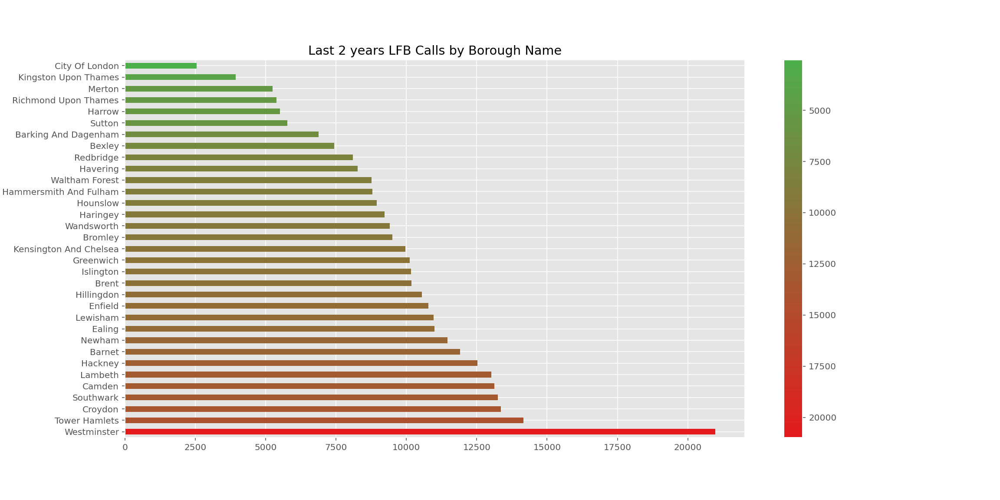

In [36]:
# Plot
lfb_by_borough.plot(kind='barh', figsize=[16,8], title='Last 2 years LFB Calls by Borough Name', color=cmap(norm(lfb_by_borough.values)))
cbar = plt.colorbar(plt.cm.ScalarMappable(norm=norm, cmap=cmap))
cbar.ax.invert_yaxis()
plt.show()

### LFB Calls By Outcome Level between the year 22-23

In [37]:
london_filtered.head()

,IncidentNumber,DateOfCall,CalYear,TimeOfCall,HourOfCall,IncidentGroup,StopCodeDescription,SpecialServiceType,PropertyCategory,PropertyType,AddressQualifier,Postcode_full,Postcode_district,UPRN,USRN,IncGeo_BoroughCode,IncGeo_BoroughName,ProperCase,IncGeo_WardCode,IncGeo_WardName,IncGeo_WardNameNew,Easting_m,Northing_m,Easting_rounded,Northing_rounded,Latitude,Longitude,FRS,IncidentStationGround,FirstPumpArriving_AttendanceTime,FirstPumpArriving_DeployedFromStation,SecondPumpArriving_AttendanceTime,SecondPumpArriving_DeployedFromStation,NumStationsWithPumpsAttending,NumPumpsAttending,PumpCount,PumpHoursRoundUp,Notional Cost (£),NumCalls
98568,000004-01012021,2021-01-01,2021,00:06:47,0,False Alarm,AFA,NaN,Non Residential,Single shop,Correct incident location,N10 3RU,N10,1.000210e+11,21106387,E09000014,HARINGEY,Haringey,E05013594,Muswell Hill,Muswell Hill,528726.0,189566.0,528750,189550,51.590253,-0.143174,London,Hornsey,181.0,Hornsey,NaN,NaN,1.0,1.0,1.0,1.0,346.0,1.0
98569,000005-01012021,2021-01-01,2021,00:07:46,0,Fire,Secondary Fire,NaN,Outdoor,Tree scrub,Open land/water - nearest gazetteer location,IG8 0EG,IG8,1.000230e+11,22304992,E09000026,REDBRIDGE,Redbridge,E05011249,MONKHAMS,MONKHAMS,540703.0,191739.0,540750,191750,51.606923,0.030486,London,Woodford,250.0,Woodford,NaN,NaN,1.0,1.0,1.0,1.0,346.0,1.0
98570,000006-01012021,2021-01-01,2021,00:08:21,0,False Alarm,False alarm - Good intent,NaN,Outdoor,Road surface/pavement,In street close to gazetteer location,RM10 9RL,RM10,1.000538e+08,19900653,E09000002,BARKING AND DAGENHAM,Barking And dagenham,E05014070,Village,Village,549510.0,184560.0,549550,184550,51.540145,0.154515,London,Dagenham,376.0,Dagenham,NaN,NaN,1.0,1.0,1.0,1.0,346.0,1.0
98571,000007-01012021,2021-01-01,2021,00:12:16,0,False Alarm,False alarm - Good intent,NaN,Dwelling,Purpose Built Flats/Maisonettes - 4 to 9 storeys,Correct incident location,NaN,SW19,0.000000e+00,22904755,E09000032,WANDSWORTH,Wandsworth,E05014029,West Hill,West Hill,NaN,NaN,524150,173450,NaN,NaN,London,Wandsworth,409.0,Wandsworth,445.0,Fulham,5.0,5.0,5.0,2.0,692.0,4.0
98572,000009-01012021,2021-01-01,2021,00:14:51,0,Fire,Primary Fire,NaN,Road Vehicle,Car,In street outside gazetteer location,E7 9AD,E7,4.606849e+07,22207891,E09000025,NEWHAM,Newham,E05013912,Forest Gate South,Forest Gate South,540409.0,185090.0,540450,185050,51.547249,0.023585,London,Stratford,362.0,Stratford,NaN,NaN,1.0,1.0,1.0,1.0,346.0,2.0


In [38]:
copy_london = london_filtered.copy()
copy_london['IncGeo_WardName'] = copy_london['IncGeo_WardName'].str.title()
outcome_level = copy_london.groupby(['IncGeo_WardName', 'IncGeo_WardCode', 'ProperCase'])["NumCalls"].sum().sort_values(ascending=False)

outcome_level

IncGeo_WardName                       IncGeo_WardCode  ProperCase            
West End                              E05013808        Westminster               4702.0
St. James'S                           E05013806        Westminster               3639.0
Heathrow Villages                     E05013570        Hillingdon                2180.0
Holborn & Covent Garden               E05013662        Camden                    1711.0
Bloomsbury                            E05013653        Camden                    1707.0
Fairfield                             E05011468        Croydon                   1501.0
Marylebone                            E05013801        Westminster               1433.0
Stonebridge                           E05013510        Brent                     1212.0
Bunhill                               E05013699        Islington                 1191.0
Whitechapel                           E05009336        Tower Hamlets             1183.0
Rainham & Wennington                  E050

In [39]:
outcome_level[-10:]

IncGeo_WardName                       IncGeo_WardCode  ProperCase
Mottingham, Coldharbour & New Eltham  E05014086        Bromley       1.0
Thamesmead Moorings                   E05000228        Greenwich     1.0
New Cross                             E05000449        Lewisham      1.0
Clerkenwell                           E05013702        Camden        1.0
Telegraph Hill                        E05013732        Southwark     1.0
New Cross Gate                        E05013728        Southwark     1.0
Telegraph Hill                        E05000453        Lewisham      1.0
Streatham St. Leonard'S               E05014115        Wandsworth    1.0
Stratford And New Town                E05000492        Newham        1.0
Sydenham                              E05013731        Bromley       1.0
Name: NumCalls, dtype: float64

<Axes: title={'center': 'Calls by Outcome Level'}, ylabel='IncGeo_WardName,IncGeo_WardCode,ProperCase'>

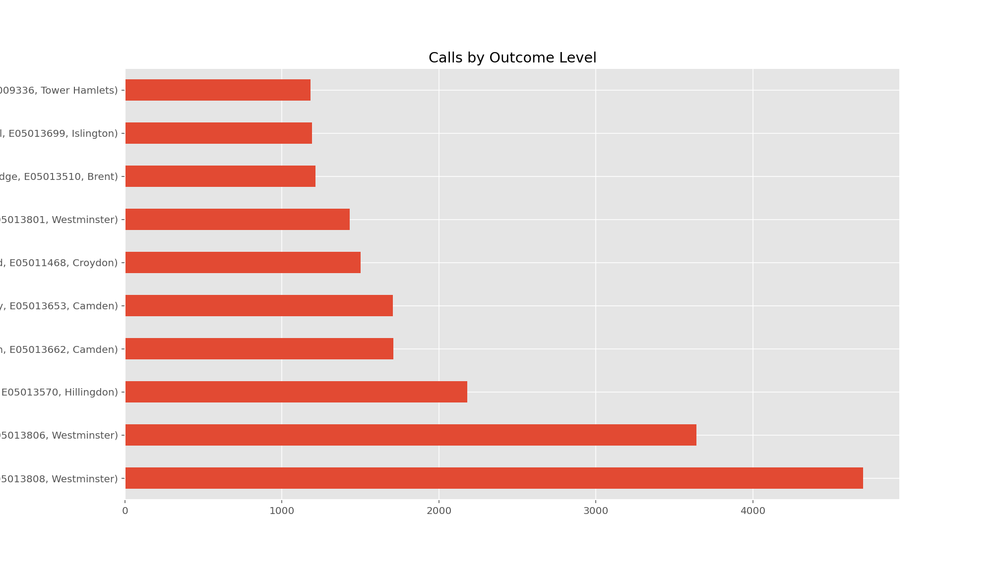

In [40]:
outcome_level[:10].plot(kind='barh', figsize=[14,8], title='Calls by Outcome Level')

In [41]:
london.groupby(['IncidentStationGround']).size().sort_values(ascending=False)[:10]

IncidentStationGround
Soho                10368
Paddington           8534
Lambeth              6754
Euston               6568
Shoreditch           6244
North Kensington     6209
Tottenham            6115
Chelsea              5794
Hammersmith          5735
Stoke Newington      5399
dtype: int64

<Axes: title={'center': 'Calls by Incident Station Ground'}, ylabel='IncidentStationGround'>

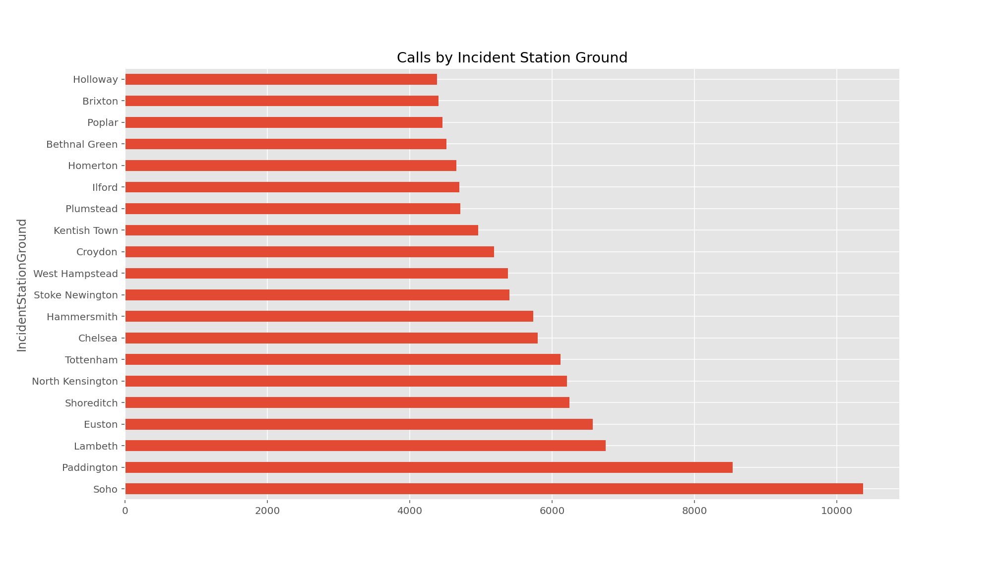

In [42]:
london.groupby(['IncidentStationGround']).size().sort_values(ascending=False).nlargest(20)\
    .plot(kind='barh', figsize=[14,8], title='Calls by Incident Station Ground')

In [43]:
# Define the projection
wgs84 = pyproj.Proj("epsg:4326") # WGS 84 - latitude and longitude
osng = pyproj.Proj("epsg:27700") # British National Grid

# Define the transformer
transformer = pyproj.Transformer.from_proj(osng, wgs84)

# Create a function to convert Easting/Northing to Lon/Lat
def to_lonlat(easting, northing):
    lon, lat = transformer.transform(easting, northing)
    return Point(lon, lat)

# Apply the function to the Easting and Northing columns
london['geometry'] = london.apply(lambda row: to_lonlat(row.Easting_rounded, row.Northing_rounded), axis=1)

# Convert the DataFrame to a GeoDataFrame
geo_london = gpd.GeoDataFrame(london, geometry='geometry')

/Users/mahsumkocabey/opt/anaconda3/lib/python3.8/site-packages/pandas/core/dtypes/cast.py:128: ShapelyDeprecationWarning:

The array interface is deprecated and will no longer work in Shapely 2.0. Convert the '.coords' to a numpy array instead.



In [44]:
start_date = pd.Timestamp("2022-01-01").date()
end_date = pd.Timestamp("2023-01-31").date()

# Filter dataframe based on date range
geo_london_23 = geo_london[(geo_london['DateOfCall'] >= start_date) 
                         & (geo_london['DateOfCall'] <= end_date)]


In [45]:
geo_london_23.head()

,IncidentNumber,DateOfCall,CalYear,TimeOfCall,HourOfCall,IncidentGroup,StopCodeDescription,SpecialServiceType,PropertyCategory,PropertyType,AddressQualifier,Postcode_full,Postcode_district,UPRN,USRN,IncGeo_BoroughCode,IncGeo_BoroughName,ProperCase,IncGeo_WardCode,IncGeo_WardName,IncGeo_WardNameNew,Easting_m,Northing_m,Easting_rounded,Northing_rounded,Latitude,Longitude,FRS,IncidentStationGround,FirstPumpArriving_AttendanceTime,FirstPumpArriving_DeployedFromStation,SecondPumpArriving_AttendanceTime,SecondPumpArriving_DeployedFromStation,NumStationsWithPumpsAttending,NumPumpsAttending,PumpCount,PumpHoursRoundUp,Notional Cost (£),NumCalls,geometry
208145,000001-01012022,2022-01-01,2022,00:00:32,0,False Alarm,False alarm - Good intent,NaN,Dwelling,Purpose Built Flats/Maisonettes - 4 to 9 storeys,Within same building,NaN,W1U,0.000000e+00,8401559,E09000033,WESTMINSTER,Westminster,E05013801,Marylebone,Marylebone,NaN,NaN,528350,181550,NaN,NaN,London,Euston,563.0,Soho,NaN,NaN,1.0,1.0,1.0,1.0,352.0,1.0,POINT (51.51830 -0.15155)
208146,000002-01012022,2022-01-01,2022,00:02:30,0,Fire,Secondary Fire,NaN,Outdoor Structure,Common external bin storage area,Correct incident location,HA1 2LW,HA1,2.000000e+11,21201074,E09000015,HARROW,Harrow,E05013546,Greenhill,Greenhill,515799.0,188349.0,515750,188350,51.582116,-0.330087,London,Harrow,361.0,Harrow,NaN,NaN,1.0,1.0,1.0,1.0,352.0,1.0,POINT (51.58213 -0.33082)
208147,000003-01012022,2022-01-01,2022,00:02:42,0,Fire,Primary Fire,NaN,Non Residential,Private Garden Shed,On land associated with building,NaN,E6,0.000000e+00,22200508,E09000025,NEWHAM,Newham,E05013905,Boleyn,Boleyn,NaN,NaN,541950,183050,NaN,NaN,London,East Ham,289.0,East Ham,376.0,Plaistow,2.0,2.0,2.0,1.0,352.0,1.0,POINT (51.52852 0.04494)
208148,000004-01012022,2022-01-01,2022,00:03:44,0,Fire,Secondary Fire,NaN,Outdoor Structure,Large refuse/rubbish container (eg skip/ paladin),In street outside gazetteer location,UB5 4JA,UB5,1.203722e+07,20601914,E09000009,EALING,Ealing,E05013531,Northolt Mandeville,Northolt Mandeville,512412.0,185072.0,512450,185050,51.553348,-0.379997,London,Northolt,303.0,Northolt,NaN,NaN,1.0,1.0,1.0,1.0,352.0,1.0,POINT (51.55314 -0.37949)
208149,000005-01012022,2022-01-01,2022,00:05:02,0,Fire,Secondary Fire,NaN,Outdoor,Loose refuse,In street remote from gazetteer location,IG8 9NR,IG8,1.000230e+11,22819625,E09000031,WALTHAM FOREST,Waltham Forest,E05013889,Hale End & Highams Park South,Hale End & Highams Park South,539005.0,191687.0,539050,191650,51.606870,0.005958,London,Woodford,286.0,Woodford,NaN,NaN,1.0,1.0,1.0,1.0,352.0,1.0,POINT (51.60652 0.00656)


In [46]:
def generateBaseMap(loc, zoom=10, tiles='stamentoner', crs='ESPG2263'):
    return folium.Map(location=loc,
                   control_scale=True, 
                   zoom_start=zoom,
                   tiles=tiles)

In [47]:
# Create a map centered around London
m = folium.Map(location=[51.5074, -0.1278], zoom_start=10)

# Ensure you're handing it floats
geo_london_23['lat'] = [geom.x for geom in geo_london_23.geometry]
geo_london_23['lon'] = [geom.y for geom in geo_london_23.geometry]

df_folium_23 = pd.DataFrame({'Lat':geo_london_23['lat'],'Long':geo_london_23['lon'],'Count':geo_london_23['NumCalls']})

df_folium_23['weight'] = df_folium_23['Count'] / df_folium_23['Count'].abs().max()

base_map = generateBaseMap([51.5074, -0.1278])  # London coordinates

# Drop the rows in the dataframe that contain NaN values
map_values_23 = df_folium_23[['Lat','Long','weight']].dropna()

# Convert the cleaned data to a list
data = map_values_23.values.tolist()

# Rest of your code
hm = HeatMap(data, gradient={0.1: 'blue', 0.3: 'lime', 0.5: 'yellow', 0.7: 'orange', 1: 'red'}, 
                min_opacity=0.05, 
                max_opacity=0.9, 
                radius=25,
                use_local_extrema=False)

base_map.add_child(hm)

# Save the map as .html
base_map.save('../figures/HeatMap_Figs/LFB HeatMap of Last Year Alone.html')
# Show the map
base_map

/Users/mahsumkocabey/opt/anaconda3/lib/python3.8/site-packages/geopandas/geodataframe.py:1456: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

/Users/mahsumkocabey/opt/anaconda3/lib/python3.8/site-packages/geopandas/geodataframe.py:1456: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



In [48]:
# Create a map centered around London
m = folium.Map(location=[51.5074, -0.1278], zoom_start=10)

# Ensure you're handing it floats
geo_london['lat'] = [geom.x for geom in geo_london.geometry]
geo_london['lon'] = [geom.y for geom in geo_london.geometry]

df_folium = pd.DataFrame({'Lat':geo_london['lat'],'Long':geo_london['lon'],'Count':geo_london['NumCalls']})

df_folium['weight'] = df_folium['Count'] / df_folium['Count'].abs().max()

In [49]:
base_map = generateBaseMap([51.5074, -0.1278])  # London coordinates

# Drop the rows in the dataframe that contain NaN values
map_values1 = df_folium[['Lat','Long','weight']].dropna()

# Convert the cleaned data to a list
data = map_values1.values.tolist()

# Rest of your code
hm = HeatMap(data, gradient={0.1: 'blue', 0.3: 'lime', 0.5: 'yellow', 0.7: 'orange', 1: 'red'}, 
                min_opacity=0.05, 
                max_opacity=0.9, 
                radius=25,
                use_local_extrema=False)

base_map.add_child(hm)

# Save the map as .html
base_map.save('../figures/HeatMap_Figs/LFB HeatMap of Last 3 Years Alone.html')
# Show the map
base_map